In [2]:
import os
import sys
from os import listdir
from os.path import isfile, join
import IPython.display as ipd
import librosa 
import librosa.display
%matplotlib inline
import matplotlib.pyplot as plt
import pandas as pd
from scipy.io import wavfile as wav
import numpy as np
from timeit import default_timer as timer

In [3]:
filename ="UrbanSound8K/audio/fold1/7383-3-0-0.wav"

In [4]:
ipd.Audio(filename)

In [5]:
def extract_MFCC(filename):
    audio, sample_rate=librosa.load(filename, res_type='kaiser_fast')
    mfccs=np.mean(librosa.feature.mfcc(y=audio, sr=sample_rate , n_mfcc=100).T,axis=0)
    
    return mfccs

In [6]:
count_2=0
filename= "UrbanSound8K/audio/fold1/103074-7-0-1.wav"
mfccs=extract_MFCC(filename)
features=np.reshape((mfccs),(20,5))
count_2+=1

In [7]:
metadata=pd.read_csv('UrbanSound8K/Augmented_metadata/UrbanSound8k_Augmented.csv')
metadata_ori=pd.read_csv('UrbanSound8K/metadata/UrbanSound8K.csv')
metadata.head()

,file,fold,class_id,class,augment
0,101415-3-0-2.wav,1,3,dog_bark,pitch_-2
1,101415-3-0-3.wav,1,3,dog_bark,pitch_-2
2,101415-3-0-8.wav,1,3,dog_bark,pitch_-2
3,102106-3-0-0.wav,1,3,dog_bark,pitch_-2
4,102842-3-0-1.wav,1,3,dog_bark,pitch_-2


In [8]:
metadata_ori=pd.read_csv('UrbanSound8K/metadata/UrbanSound8K.csv')
metadata_ori.head()

,slice_file_name,fsID,start,end,salience,fold,classID,class
0,100032-3-0-0.wav,100032,0.0,0.317551,1,5,3,dog_bark
1,100263-2-0-117.wav,100263,58.5,62.500000,1,5,2,children_playing
2,100263-2-0-121.wav,100263,60.5,64.500000,1,5,2,children_playing
3,100263-2-0-126.wav,100263,63.0,67.000000,1,5,2,children_playing
4,100263-2-0-137.wav,100263,68.5,72.500000,1,5,2,children_playing


In [9]:
fold_list = ['fold1', 'fold2', 'fold3', 'fold4', 'fold5', 'fold6', 'fold7', 'fold8', 'fold9', 'fold10']

In [10]:
Augment_list= ['pitch_2', 'pitch_-2','pitch_time290','pitch_time-290','pitch_time2110','pitch_time-2110','speed_90','speed_110']

In [11]:
stacked_features = []
exceptions=0
count_1=0
count_2=0
labels=['dog_bark', 'gun_shot', 'jackhammer', 'engine_idling',
       'children_playing', 'siren', 'street_music', 'air_conditioner',
       'drilling', 'car_horn']

start_time = timer()
for i in range(10):
    for j in range(8):
  
        mypath = 'UrbanSound8K/Augmented_audio/'+ fold_list[i] + '/' + Augment_list[j] + '/'
        files = [mypath + f for f in listdir(mypath) if isfile(join(mypath, f))]

        for fn in files:
            try: 
                mfccs = extract_MFCC(fn)
                features=np.reshape((mfccs),(20,5))
                count_1+=1

            except: 
                print(fn)
                exceptions += 1
                continue

            l_row = metadata.loc[metadata['file']==fn.split('/')[-1]].values.tolist()
            #print(l_row)
            label = l_row[0][-2]
            if label not in labels:
                raise Exception("\n Sorry, there is an error in the code.")
                
            #print(label)
            #exit()
            fold = i+1
            

            stacked_features.append([features, features.shape, label, fold])

            
for w in range(10):
    # get file names
    mypath = 'UrbanSound8K/audio/'+ fold_list[w] + '/'
    files = [mypath + f for f in listdir(mypath) if isfile(join(mypath, f))]
    
    for fn in files:
        try: # extract features
            mfccs = extract_MFCC(fn)
            features=np.reshape((mfccs),(20,5))
            count_2+=1
            
        except: # else exception (.ds_store files are part of mac file systems)
            print(fn)
            exceptions += 1
            continue
            
        l_row = metadata_ori.loc[metadata_ori['slice_file_name']==fn.split('/')[-1]].values.tolist()
        label = l_row[0][-1]
        if label not in labels:
                raise Exception("\n Sorry, there is an error in the code.")
        fold = w+1
    
        stacked_features.append([features, features.shape, label, fold])
        
        
print("Exceptions: ", exceptions)
end_time = timer()
print(print("time taken: {0} minutes {1:.1f} seconds".format((end_time - start_time)//60, (end_time - start_time)%60)))
print('Finished feature extraction from all folder')
print("Total features extracted from augmented part {}".format(count_1))
print("Total features extracted from non augmented part {}".format(count_2))

C:\Users\pc\Anaconda3\lib\site-packages\librosa\core\spectrum.py:222: UserWarning: n_fft=2048 is too small for input signal of length=1103
  warnings.warn(
C:\Users\pc\Anaconda3\lib\site-packages\librosa\core\spectrum.py:222: UserWarning: n_fft=2048 is too small for input signal of length=1323
  warnings.warn(
C:\Users\pc\Anaconda3\lib\site-packages\librosa\core\spectrum.py:222: UserWarning: n_fft=2048 is too small for input signal of length=1523
  warnings.warn(
C:\Users\pc\Anaconda3\lib\site-packages\librosa\core\spectrum.py:222: UserWarning: n_fft=2048 is too small for input signal of length=1226
  warnings.warn(
C:\Users\pc\Anaconda3\lib\site-packages\librosa\core\spectrum.py:222: UserWarning: n_fft=2048 is too small for input signal of length=1470
  warnings.warn(
C:\Users\pc\Anaconda3\lib\site-packages\librosa\core\spectrum.py:222: UserWarning: n_fft=2048 is too small for input signal of length=1692
  warnings.warn(
C:\Users\pc\Anaconda3\lib\site-packages\librosa\core\spectrum.py

UrbanSound8K/audio/fold1/.DS_Store
UrbanSound8K/audio/fold2/.DS_Store
UrbanSound8K/audio/fold3/.DS_Store
UrbanSound8K/audio/fold4/.DS_Store
UrbanSound8K/audio/fold5/.DS_Store
UrbanSound8K/audio/fold6/.DS_Store
UrbanSound8K/audio/fold7/.DS_Store
UrbanSound8K/audio/fold8/.DS_Store
UrbanSound8K/audio/fold9/.DS_Store
UrbanSound8K/audio/fold10/.DS_Store
Exceptions:  10
time taken: 117.0 minutes 23.3 seconds
None
Finished feature extraction from all folder
Total features extracted from augmented part 69856
Total features extracted from non augmented part 8732


In [12]:
cols=['Stacked_Features', 'Matrix_Shape', 'Label', 'Fold']
Stacked_feature_pd=pd.DataFrame(data=stacked_features , columns=cols)
Stacked_feature_pd.head()
#Stacked_feature_pd.to_csv('C:/Users/16301148/Desktop/tHESIS/MFCC_features_CNN/MFCC_features_CNN.csv', index=False)

,Stacked_Features,Matrix_Shape,Label,Fold
0,"[[-428.42056, 98.57241, 10.260828, -19.94915, ...","(20, 5)",dog_bark,1
1,"[[-383.46613, 132.247, 17.835365, -33.931313, ...","(20, 5)",dog_bark,1
2,"[[-462.8479, 78.49388, 6.611009, -3.8108122, 1...","(20, 5)",dog_bark,1
3,"[[-282.7671, 93.10348, -51.64786, -12.338222, ...","(20, 5)",dog_bark,1
4,"[[-409.95215, 125.347595, 28.116976, 12.195362...","(20, 5)",gun_shot,1


In [64]:
print(Stacked_feature_pd["Stacked_Features"][0].shape)

(20, 5)


In [71]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
for i in range(78588):
        Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
#Stacked_feature_pd["Stacked_Features"]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"])
Stacked_feature_pd.head()

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stacked_feature_pd["Stacked_Features"][i]=scaler.fit_transform(Stacked_feature_pd["Stacked_Features"][i])
<ipython-input-71-9bef910d1b8c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

,Stacked_Features,Matrix_Shape,Label,Fold
0,"[[-4.358142, 4.2837567, 3.2521718, -3.57721, -...","(20, 5)",dog_bark,1
1,"[[-4.3573995, 4.2127333, 3.2380152, -3.560509,...","(20, 5)",dog_bark,1
2,"[[-4.3585305, 4.3120575, 3.5857399, -1.5899221...","(20, 5)",dog_bark,1
3,"[[-4.349281, 4.312529, -4.26296, -3.0056243, -...","(20, 5)",dog_bark,1
4,"[[-4.3572116, 4.344746, 3.844825, 2.9468699, -...","(20, 5)",gun_shot,1


In [72]:
Stacked_feature_pd.head()

,Stacked_Features,Matrix_Shape,Label,Fold
0,"[[-4.358142, 4.2837567, 3.2521718, -3.57721, -...","(20, 5)",dog_bark,1
1,"[[-4.3573995, 4.2127333, 3.2380152, -3.560509,...","(20, 5)",dog_bark,1
2,"[[-4.3585305, 4.3120575, 3.5857399, -1.5899221...","(20, 5)",dog_bark,1
3,"[[-4.349281, 4.312529, -4.26296, -3.0056243, -...","(20, 5)",dog_bark,1
4,"[[-4.3572116, 4.344746, 3.844825, 2.9468699, -...","(20, 5)",gun_shot,1


In [76]:
from sklearn.preprocessing import LabelEncoder
from keras.utils import to_categorical

X = np.array(Stacked_feature_pd.Stacked_Features.tolist())
y = np.array(Stacked_feature_pd.Label.tolist())


le = LabelEncoder()
yy = to_categorical(le.fit_transform(y))
print(yy.shape)

(78588, 10)


In [77]:
from sklearn.model_selection import train_test_split 

x_train, x_test, y_train, y_test = train_test_split(X, yy, test_size=0.2,random_state=42)

In [78]:
print(x_train.shape, x_test.shape, y_train.shape, y_test.shape, yy.shape)

(62870, 20, 5) (15718, 20, 5) (62870, 10) (15718, 10) (78588, 10)


In [79]:
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten
from keras.layers import Convolution2D, Conv1D, MaxPooling1D, GlobalAveragePooling2D, LSTM, TimeDistributed
from keras.optimizers import Adam
from keras.utils import np_utils
from sklearn import metrics

In [80]:
model=Sequential()
model.add(Conv1D(64, kernel_size=3, padding="Same", activation="relu", input_shape=(20,5)))
model.add(MaxPooling1D(padding="same"))
model.add(Conv1D(128, kernel_size=3, padding="same", activation="relu"))
model.add(MaxPooling1D(padding="Same"))
model.add(LSTM(128,return_sequences=True))
model.add(LSTM(128, return_sequences=True))

model.add(TimeDistributed(Dense(256, activation="relu")))
model.add(Dropout(0.2))
model.add(TimeDistributed(Dense(512, activation="relu")))
model.add(Dropout(0.2))
model.add(Flatten())
model.add(Dense(10, activation="softmax"))

In [81]:
model.compile(loss='categorical_crossentropy', metrics=['accuracy'], optimizer="adam")
model.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d_6 (Conv1D)            (None, 20, 64)            1024      
_________________________________________________________________
max_pooling1d_6 (MaxPooling1 (None, 10, 64)            0         
_________________________________________________________________
conv1d_7 (Conv1D)            (None, 10, 128)           24704     
_________________________________________________________________
max_pooling1d_7 (MaxPooling1 (None, 5, 128)            0         
_________________________________________________________________
lstm_6 (LSTM)                (None, 5, 128)            131584    
_________________________________________________________________
lstm_7 (LSTM)                (None, 5, 128)            131584    
_________________________________________________________________
time_distributed_6 (TimeDist (None, 5, 256)           

In [82]:
print(x_test.shape)
score = model.evaluate(x_test, y_test, verbose=1)
accuracy = 100*score[1]

print("Pre-training accuracy: %.4f%%" % accuracy)

(15718, 20, 5)
492/492 [==============================] - 8s 16ms/step - loss: 2.3017 - accuracy: 0.1274
Pre-training accuracy: 12.7370%


In [83]:
import tensorflow as tf 
class Mycallback(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs):
        if(logs["val_accuracy"]>0.99):
            print("\n Reached the required accuracy so stopped training")
            self.model.stop_training = True

In [84]:
callbacks=Mycallback()

In [85]:
start_time=timer()
history=model.fit(x_train,y_train,batch_size=50,epochs=30,validation_data=(x_test,y_test), callbacks=[callbacks])
end_time=timer()
print(print("time taken: {0} minutes {1:.1f} seconds".format((end_time - start_time)//60, (end_time - start_time)%60)))

Epoch 1/30
1258/1258 [==============================] - 51s 41ms/step - loss: 1.2718 - accuracy: 0.5538 - val_loss: 0.9084 - val_accuracy: 0.6914
Epoch 2/30
1258/1258 [==============================] - 41s 33ms/step - loss: 0.7339 - accuracy: 0.7525 - val_loss: 0.6882 - val_accuracy: 0.7685
Epoch 3/30
1258/1258 [==============================] - 41s 32ms/step - loss: 0.5427 - accuracy: 0.8178 - val_loss: 0.5003 - val_accuracy: 0.8322
Epoch 4/30
1258/1258 [==============================] - 41s 33ms/step - loss: 0.4279 - accuracy: 0.8551 - val_loss: 0.4693 - val_accuracy: 0.8414
Epoch 5/30
1258/1258 [==============================] - 41s 33ms/step - loss: 0.3448 - accuracy: 0.8829 - val_loss: 0.3547 - val_accuracy: 0.8826
Epoch 6/30
1258/1258 [==============================] - 40s 32ms/step - loss: 0.2794 - accuracy: 0.9028 - val_loss: 0.3334 - val_accuracy: 0.8880
Epoch 7/30
1258/1258 [==============================] - 39s 31ms/step - loss: 0.2282 - accuracy: 0.9219 - val_loss: 0.2830 -

In [86]:
score = model.evaluate(x_train, y_train, verbose=0)
print("Training Accuracy: ", score[1]*100)

score = model.evaluate(x_test, y_test, verbose=0)
print("Testing Accuracy: ", score[1]*100)

Training Accuracy:  99.32399988174438
Testing Accuracy:  96.81893587112427


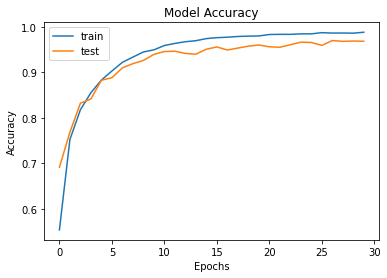

In [87]:
import matplotlib.pyplot as plt
plt.plot(history.history["accuracy"])
plt.plot(history.history["val_accuracy"])
plt.title("Model Accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(["train", "test"], loc="upper left")
plt.show()